In [1]:
import matplotlib.pyplot as plt
import numpy as np
import json

%matplotlib inline

# Reading output of AlphaPose
with open('3d_pose_extraction/alphapose-results.json') as f:
    output = json.load(f)
print(output[0].keys())

dict_keys(['image_id', 'category_id', 'keypoints', 'score', 'box', 'idx', 'pred_xyz_jts'])


In [2]:
# Checking the information for every frame
poses_per_frame = {}
for frame in output:
    image_id = int(frame['image_id'].split('.')[0])
    
    try:
        poses_per_frame[image_id] += 1
    except:
        poses_per_frame[image_id] = 1

# Are there frames in which no one is identified?
missing_frames = []
for k in [*poses_per_frame.keys()][:-1]:
    if poses_per_frame.get(k+1) is None:
        missing_frames.append(k+1)
print('Missing frames: {}\n'.format(missing_frames))

print('Possible number of people per frame: {}\n'.format(np.unique([*poses_per_frame.values()])))

# For some frames, either 3 people are identified or only 1 person is identified
less_instances = []
more_instances = []
for k, v in poses_per_frame.items():
    if v > 2:
        more_instances.append(k)
    elif v < 2:
        less_instances.append(k)
print('Frames with 1 person: {}\n'.format(less_instances))
print('Frames with 3 people: {}'.format(more_instances))

Missing frames: []

Possible number of people per frame: [1 2 3]

Frames with 1 person: [175, 176, 178, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 228, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241]

Frames with 3 people: [3, 6, 39, 40, 41, 43, 44, 47, 50, 51, 52, 155]


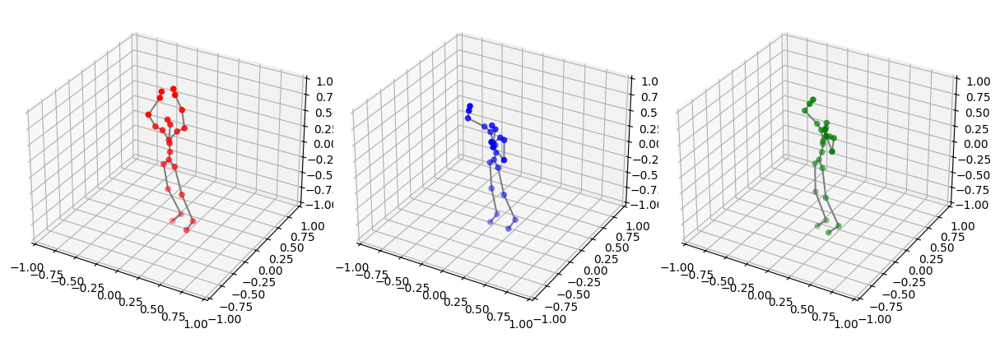

In [3]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Visualizing 3 dancers on a frame
fig = plt.figure(figsize=(12, 6))
axes = []
color = ['red', 'blue', 'green']
skeleton = [(0, 1), (0, 2), (0, 3), (1, 4), (2, 5), (3, 6), (4, 7), (5, 8), (6, 9), (7, 10),
            (8, 11), (9, 12), (9, 13), (9, 14), (12, 15), (13, 16), (14, 17), (16, 18), (17, 19), 
            (18, 20), (19, 21), (20, 22), (21, 23)]

indexes = [6, 7, 8]
for i in range(len(indexes)):
    subplot_number = 131+i
    axes.append(fig.add_subplot(subplot_number, projection="3d"))
    axes[i].set_xlim([-1, 1])
    axes[i].set_ylim([-1, 1])
    axes[i].set_zlim([-1, 1])

    scatter_points = np.array(output[indexes[i]]['pred_xyz_jts'])
    axes[i].scatter(scatter_points[:, 2], scatter_points[:, 0], -scatter_points[:, 1], color=color[i])

    for (start, end) in skeleton:
        xs = [scatter_points[start, 2], scatter_points[end, 2]]
        ys = [scatter_points[start, 0], scatter_points[end, 0]]
        zs = [-scatter_points[start, 1], -scatter_points[end, 1]]
        axes[i].plot(xs, ys, zs, color='grey')

plt.tight_layout()
plt.show()

In [4]:
# Processing frames with more or less than 2 people
filtered_output = output.copy()
wrong_instances = sorted(set(more_instances).union(set(less_instances)))

for i in wrong_instances:
    # Filtering frames with more than 2 people
    if poses_per_frame[i] > 2:
        scores = [filtered_output[i*2]['score'], filtered_output[i*2+1]['score'], filtered_output[i*2+2]['score']]
        index = np.argmin(scores)
        
        if index == 0:
            filtered_output.pop(i*2)
        elif index == 1:
            filtered_output.pop(i*2+1)
        else:
            filtered_output.pop(i*2+2)

    # Enriching frames with only 1 person
    elif poses_per_frame[i] < 2:
        only_person = np.array(filtered_output[i*2]['pred_xyz_jts'])
        to_compare_1 = np.array(filtered_output[i*2-1]['pred_xyz_jts'])
        to_compare_2 = np.array(filtered_output[i*2-2]['pred_xyz_jts'])
        
        distance_1 = np.sum(np.linalg.norm(only_person - to_compare_1))
        distance_2 = np.sum(np.linalg.norm(only_person - to_compare_2))

        if distance_1 > distance_2:
            new_data = filtered_output[i*2-1].copy()
            new_data['image_id'] = filtered_output[i*2]['image_id']
            filtered_output.insert(i*2+1, new_data)
        else:
            new_data = filtered_output[i*2-2].copy()
            new_data['image_id'] = filtered_output[i*2]['image_id']
            filtered_output.insert(i*2, new_data)
        
filtered_poses_per_frame = {}
for frame in filtered_output:
    image_id = int(frame['image_id'].split('.')[0])
    
    try:
        filtered_poses_per_frame[image_id] += 1
    except:
        filtered_poses_per_frame[image_id] = 1
print('Possible number of people per frame: {}\n'.format(np.unique([*filtered_poses_per_frame.values()])))

Possible number of people per frame: [2]



In [5]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

fig = plt.figure(figsize=(12, 6))

ax1 = fig.add_subplot(121, projection="3d")
ax1.set_xlim([-1, 1])
ax1.set_ylim([-1, 1])
ax1.set_zlim([-1, 1])
scatt1 = ax1.scatter([], [], [], color='red')
#lines1 = [ax1.plot([], [], [], 'gray')[0] for _ in skeleton]

ax2 = fig.add_subplot(122, projection="3d")
ax2.set_xlim([-1, 1])
ax2.set_ylim([-1, 1])
ax2.set_zlim([-1, 1])
scatt2 = ax2.scatter([], [], [], color='blue')
#lines2 = [ax2.plot([], [], [], 'gray')[0] for _ in skeleton]

person_1_poses = []
person_2_poses = []
for i, frame in enumerate(filtered_output):
    if i%2 == 0:
        person_1_poses.append(frame['pred_xyz_jts'])
    else:
        person_2_poses.append(frame['pred_xyz_jts'])
person_1_poses = np.array(person_1_poses)
person_2_poses = np.array(person_2_poses)

poses_1_x = person_1_poses[:120, :, 2]
poses_1_y = person_1_poses[:120, :, 0]
poses_1_z = -person_1_poses[:120, :, 1]

poses_2_x = person_2_poses[:120, :, 2]
poses_2_y = person_2_poses[:120, :, 0]
poses_2_z = -person_2_poses[:120, :, 1]

# transl = output['transl']
# pred_camera = output['pred_camera']

# def camera_transformation(x, y, z, transl, pred_camera):
#     x = (x + transl[0]) * pred_camera
#     y = (y + transl[1]) * pred_camera
#     z = (z + transl[2]) * pred_camera

#     return x, y, z

def update(frame):
    # x_frame, y_frame, z_frame = camera_transformation(poses_x[frame], poses_y[frame], poses_z[frame], \
    #                                                   transl[frame], pred_camera[frame])
    
    scatt1._offsets3d = (poses_1_x[frame], poses_1_y[frame], poses_1_z[frame])
    scatt2._offsets3d = (poses_2_x[frame], poses_2_y[frame], poses_2_z[frame])

    # for line, (start, end) in zip(lines1, skeleton):
    #     line.set_data([poses_1_x[frame, start], poses_1_x[frame, end]], [poses_1_y[frame, start], poses_1_y[frame, end]])
    #     line.set_3d_properties([poses_1_z[frame, start], poses_1_z[frame, end]])

    # for line, (start, end) in zip(lines1, skeleton):
    #     line.set_data([poses_2_x[frame, start], poses_2_x[frame, end]], [poses_2_y[frame, start], poses_2_y[frame, end]])
    #     line.set_3d_properties([poses_2_z[frame, start], poses_2_z[frame, end]])
    
    return scatt1, scatt2#, *lines1, *lines2

ani = FuncAnimation(fig, update, frames=range(len(poses_1_x)), interval=100, blit=False)
plt.close(fig)
HTML(ani.to_jshtml())

Animation size has reached 21155315 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
from IPython.display import Video

video_path = 'res_0210-0220.mp4'
Video(video_path, width=640, height=480, embed=True)